In [1]:
import os
import sys
from pathlib import Path
from typing import List

import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import skimage.io
from skimage.measure import regionprops_table
from skimage import exposure, measure, util
import seaborn as sns

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)

from config import *

In [4]:
module_path = str(Path.cwd().parents[0] / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

In [5]:
# Define image and masks folder
info_csv = data_meta / "info_combined.csv"

df = pd.read_csv(info_csv)

In [6]:
df

,Cycle,Location,Channel,Marker,Path,After_bleach
0,Cycle1,1,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
1,Cycle1,1,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,True
2,Cycle1,1,CH2,p-EGFR,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
3,Cycle1,1,CH2,p-EGFR,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,True
4,Cycle10,1,CH2,Concanavalin A,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
...,...,...,...,...,...,...
4531,Cycle9,63,CH4,H3k4me3-647,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,True
4532,Cycle9,63,CH3,H3k9Ac-555,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
4533,Cycle9,63,CH3,H3k9Ac-555,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,True
4534,Cycle9,63,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False


# loop for location 1

In [7]:
from joblib import Parallel, delayed
from skimage import exposure, io

def contrast_streching(img):
    img = img[:1000, :1000]
    p2, p98 = np.percentile(img, (0, 99.9))
    return exposure.rescale_intensity(
        img, in_range=(p2, p98), out_range=(0, 255)
    ).astype(np.uint8)

def read_img(path):
    return contrast_streching(skimage.io.imread(path))


def joblib_loop(task, pics):
    return Parallel(n_jobs=20)(delayed(task)(i) for i in pics)

In [8]:
df_subset = df[df.Location == 25]
group = df_subset.groupby(['Marker'])

In [9]:
df_subset = df_subset[df_subset.After_bleach == False]
paths = df_subset.Path.tolist()
markers = df_subset.Marker.tolist()

In [10]:
imgs = joblib_loop(read_img, paths)
imgs = np.stack(imgs)

In [11]:
# import napari

# viewer = napari.view_image(imgs[:6], channel_axis=0, name=markers[:6])

In [12]:
df_melts = []

for name, df_group in group:
    if len(df_group) != 2:
        continue
    af_path = df_group[df_group.After_bleach == True].Path.item()
    path = df_group[df_group.After_bleach == False].Path.item()

    img = skimage.io.imread(path)[350:750, 320:720]
    img_af = skimage.io.imread(af_path)[350:750, 320:720]
    
    fourrier = np.log(1+np.fft.fftshift(np.fft.fft2(img)))
    fourrier1 = np.log(1+np.fft.fftshift(np.fft.fft2(img_af)))
    
    fourrier_sum = abs(fourrier).flatten()
    fourrier_sum1 = abs(fourrier1).flatten()
    
    df_fourrier = pd.DataFrame({'Before':fourrier_sum, 'After': fourrier_sum1})
    df_melt = df_fourrier.melt(var_name='Condition', value_name=name)
    df_melts.append(df_melt)
    

In [13]:
df_fourrier = pd.concat(df_melts, axis=1)
df_fourrier = df_fourrier.loc[:,~df_fourrier.columns.duplicated()]

df_melt = df_fourrier.melt(id_vars='Condition', var_name='Marker', value_name='Fourrier Magnitude')

In [14]:
df_melt

,Condition,Marker,Fourrier Magnitude
0,Before,AKT,10.901745
1,Before,AKT,10.740153
2,Before,AKT,11.055042
3,Before,AKT,10.509742
4,Before,AKT,10.925965
...,...,...,...
7999995,After,p-mTOR,10.431638
7999996,After,p-mTOR,11.163579
7999997,After,p-mTOR,9.766644
7999998,After,p-mTOR,9.749221


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

EGFR_Before vs. EGFR_After: Mann-Whitney-Wilcoxon test two-sided, P_val:3.834e-90 U_stat=1.333e+10
EMMPRIN_Before vs. EMMPRIN_After: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.526e+10
H3k27me3-488_Before vs. H3k27me3-488_After: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=6.187e+09
H3k4me3-647_Before vs. H3k4me3-647_After: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.450e+10
H3k9Ac-555_Before vs. H3k9Ac-555_After: Mann-Whitney-Wilcoxon test two-sided, P_val:1.064e-43 U_stat=1.316e+10
Non-p-B-catenin_Before vs. Non-p-B-catenin_After: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.633e+10
PCNA_Before vs. PCNA_After: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.450e+10
Phalloidin_Before vs. Phalloidin_After: Mann-Whitney-Wil

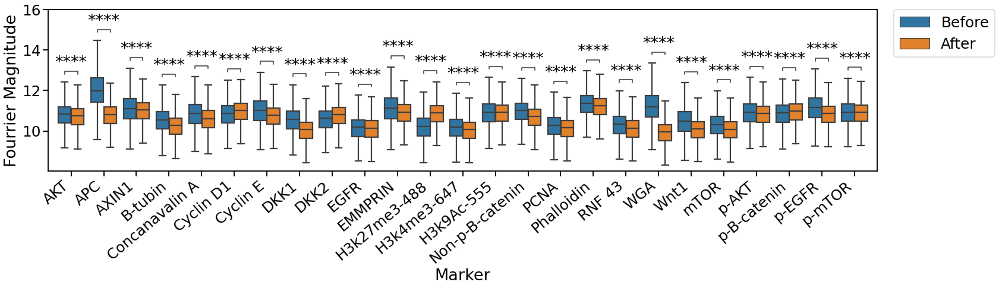

In [27]:
from statannotations.Annotator import Annotator
sns.set_context("talk", font_scale=1.5)


fig, ax = plt.subplots(figsize=(25,5))
ax = sns.boxplot(data=df_melt, x='Marker', y='Fourrier Magnitude', hue='Condition', showfliers=False) 
ax.set_xticklabels(ax.get_xticklabels(),rotation=40, ha='right')
pairs = [((marker, 'Before'), (marker, 'After')) for marker in df_melt.Marker.unique()]
annot = Annotator(ax, pairs, data=df_melt, x='Marker', y='Fourrier Magnitude', hue='Condition')
annot.configure(test='Mann-Whitney', text_format='star', loc='inside', verbose=2)
annot.apply_test()
ax, test_results = annot.annotate()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

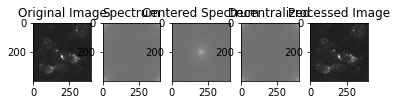

In [106]:
img_c1 = img
img_c2 = np.fft.fft2(img_c1)
img_c3 = np.fft.fftshift(img_c2)
img_c4 = np.fft.ifftshift(img_c3)
img_c5 = np.fft.ifft2(img_c4)

plt.subplot(151), plt.imshow(img_c1, "gray"), plt.title("Original Image")
plt.subplot(152), plt.imshow(np.log(1+np.abs(img_c2)), "gray"), plt.title("Spectrum")
plt.subplot(153), plt.imshow(np.log(1+np.abs(img_c3)), "gray"), plt.title("Centered Spectrum")
plt.subplot(154), plt.imshow(np.log(1+np.abs(img_c4)), "gray"), plt.title("Decentralized")
plt.subplot(155), plt.imshow(np.abs(img_c5), "gray"), plt.title("Processed Image")

plt.show()

C:\Users\thu71\AppData\Local\Temp/ipykernel_149548/3711115050.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1,2, figsize=(10,5), sharex='col', sharey='row')


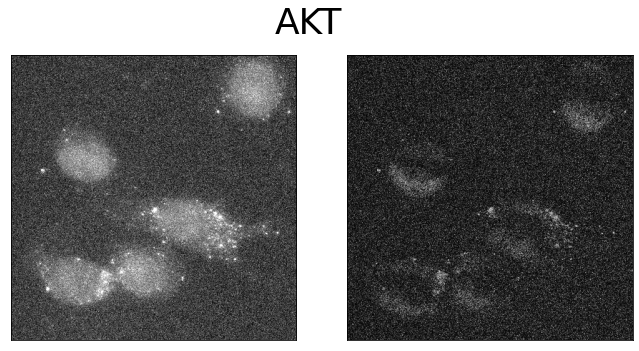

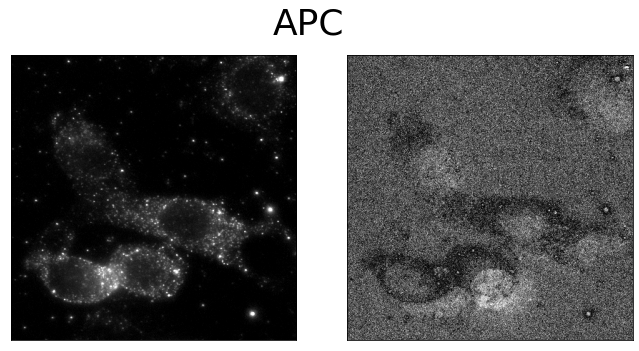

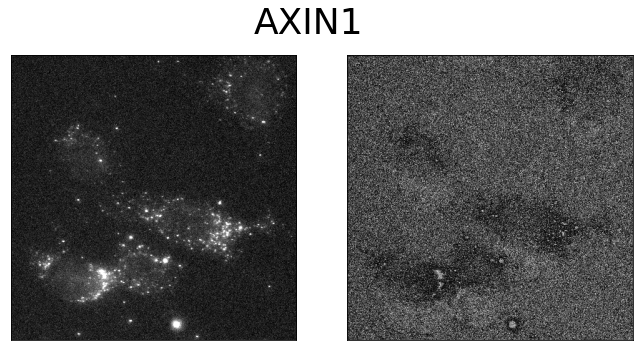

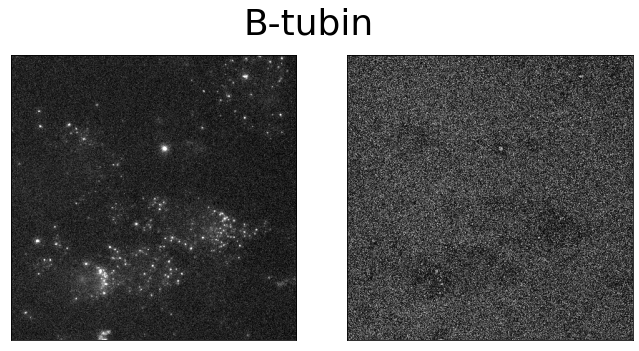

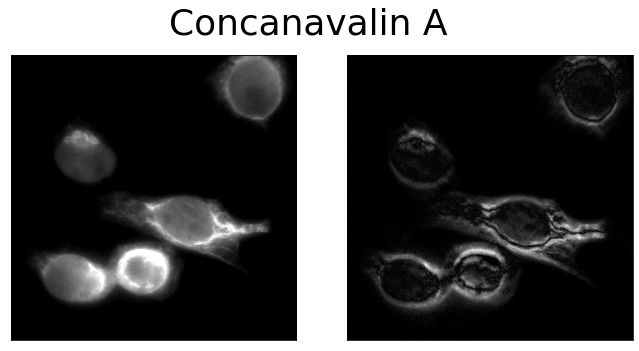

...

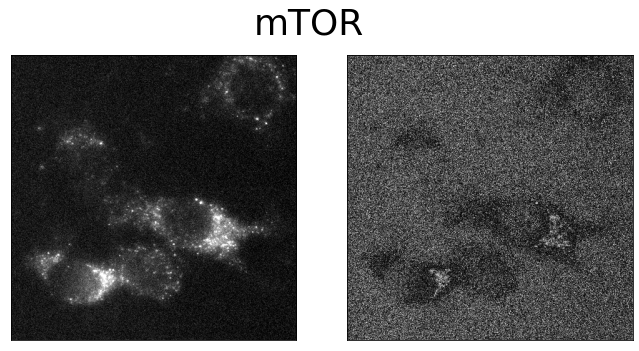

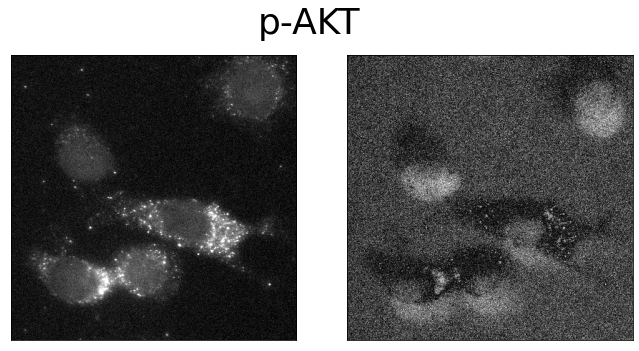

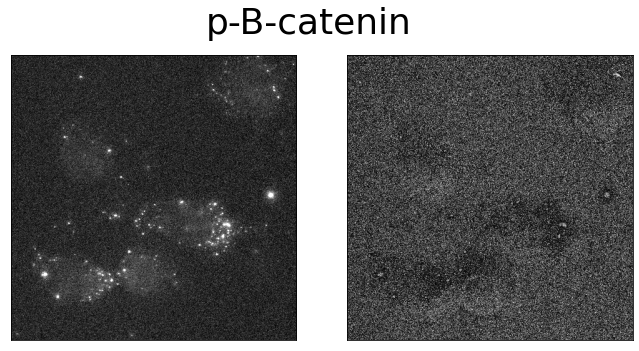

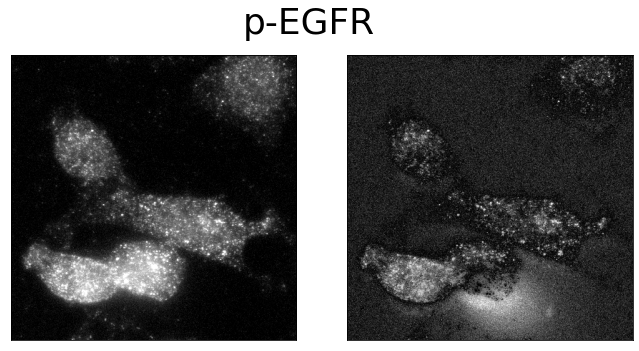

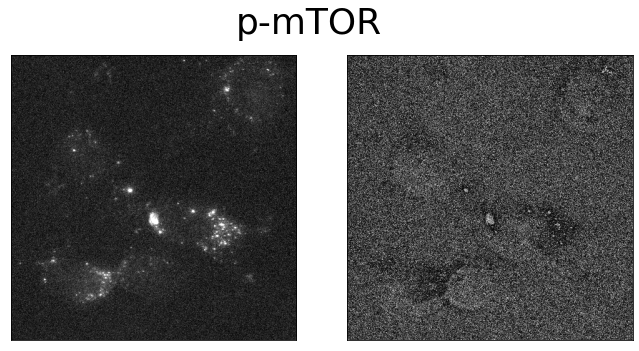

In [36]:
# for name, df_group in group:
#     if len(df_group) != 2:
#         continue
#     af_path = df_group[df_group.After_bleach == True].Path.item()
#     path = df_group[df_group.After_bleach == False].Path.item()

#     img = contrast_streching(skimage.io.imread(path))[350:750, 320:720]
#     img_af = contrast_streching(skimage.io.imread(af_path))[350:750, 320:720]
    
#     fourrier = np.fft.fftshift(np.fft.fft2(img))
#     fourrier1 = np.fft.fftshift(np.fft.fft2(img_af))
    
#     fig, axs = plt.subplots(1,2, figsize=(10,5), sharex='col', sharey='row')
#     axs = axs.flatten()
#     axs[0].imshow(img, cmap='gray', vmin=0, vmax=255)
#     axs[1].imshow(abs(np.fft.ifft2(np.fft.ifftshift(fourrier1-fourrier))), cmap='gray');
#     fig.suptitle(f'{name}', fontsize=36)
#     fig.tight_layout()
#     fig.subplots_adjust(wspace=0, hspace=0)
#     for ax in axs.flat:
#         ax.label_outer()
#         ax.axes.xaxis.set_ticks([])
#         ax.axes.yaxis.set_ticks([])
        


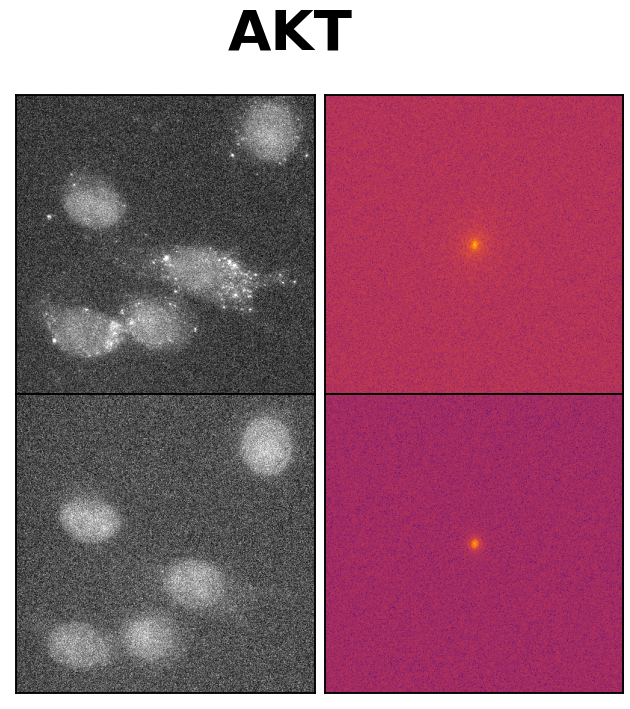

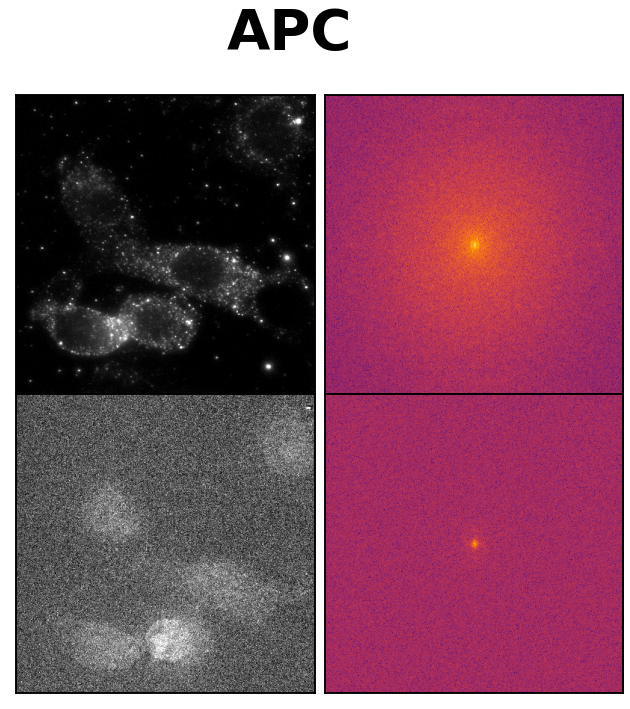

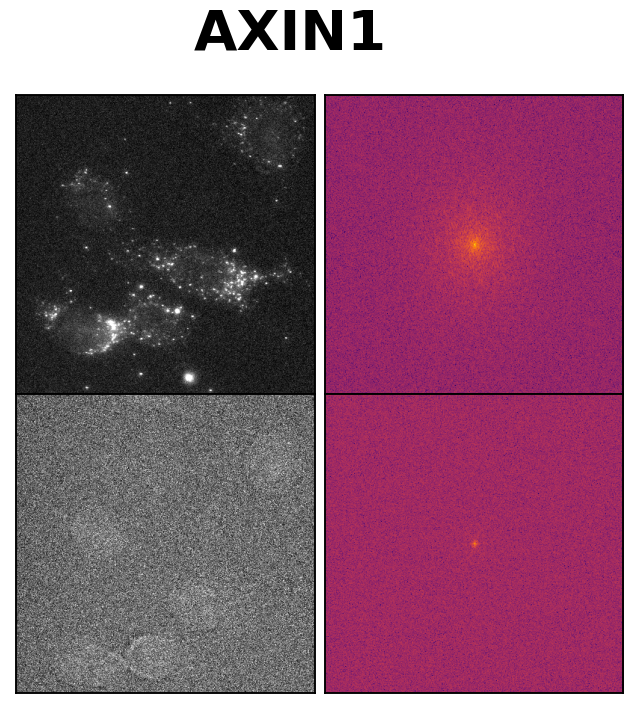

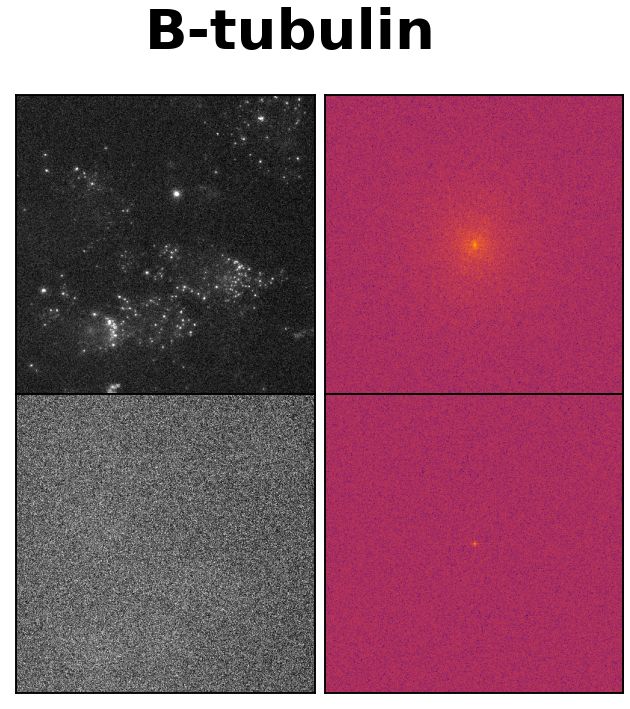

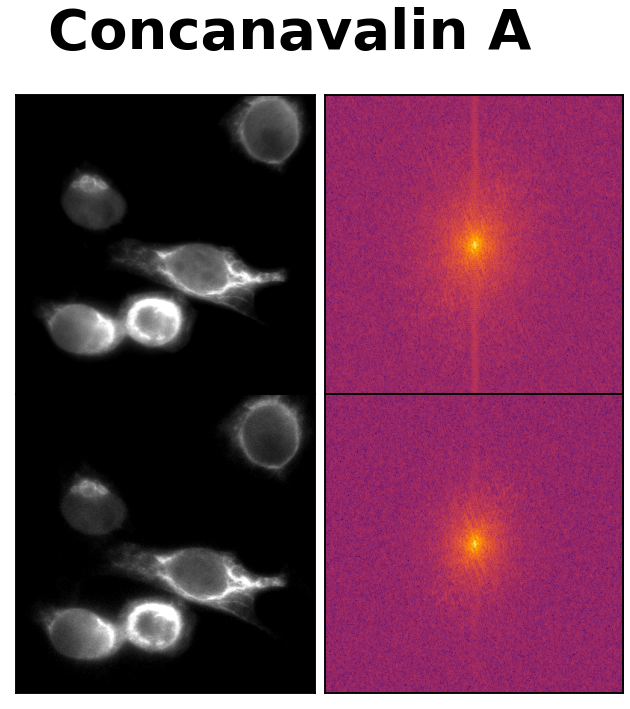

...

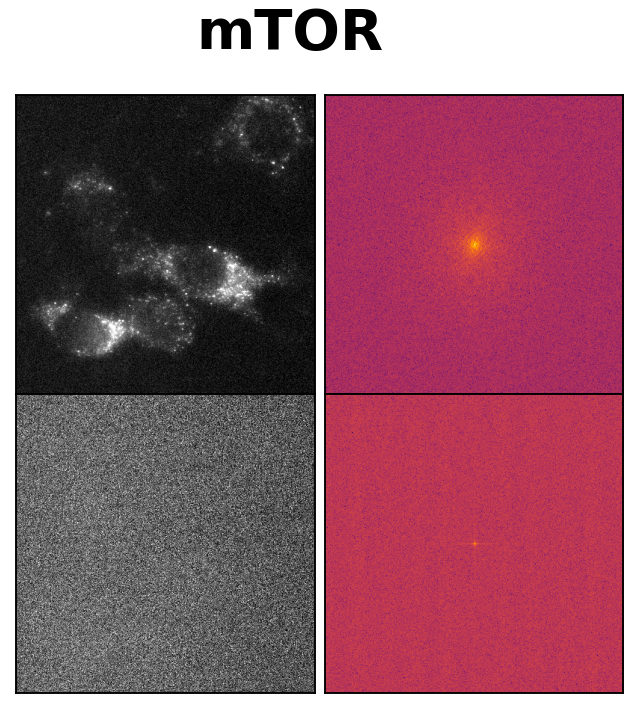

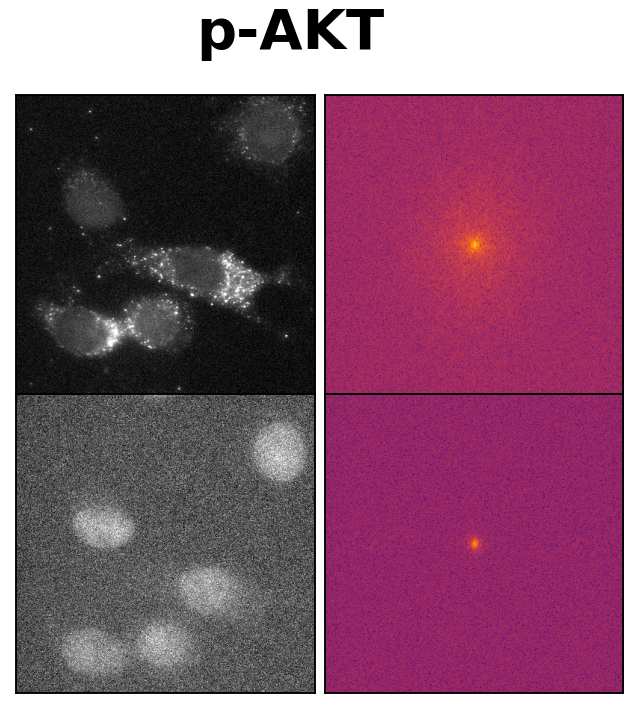

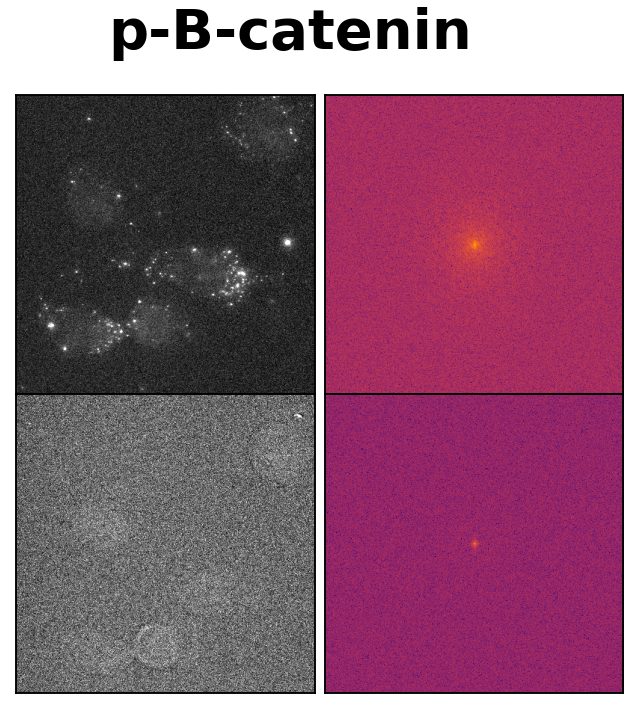

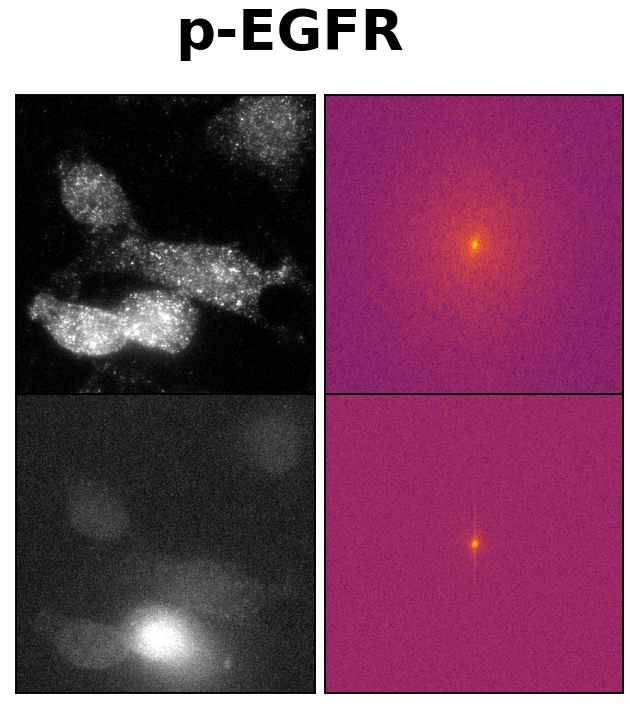

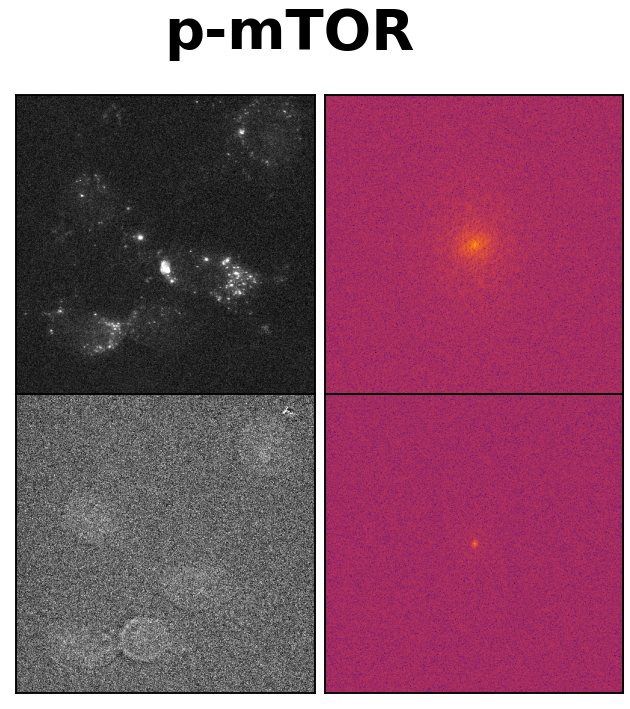

In [34]:
plt.rcParams.update({'font.size': 20})

for name, df_group in group:
    if len(df_group) != 2:
        continue
    if name == 'B-tubin':
        name = 'B-tubulin'
    af_path = df_group[df_group.After_bleach == True].Path.item()
    path = df_group[df_group.After_bleach == False].Path.item()

    img = contrast_streching(skimage.io.imread(path))[350:750, 320:720]
    img_af = contrast_streching(skimage.io.imread(af_path))[350:750, 320:720]
    
    fig, axs = plt.subplots(2,2, figsize=(10,10.5), sharex='col', sharey='row')
    axs = axs.flatten()
    axs[0].imshow(img, cmap='gray', vmin=0, vmax=255)
    fourrier = np.fft.fftshift(np.fft.fft2(img))
    axs[1].imshow(np.log(abs(fourrier)), cmap='inferno');

    axs[2].imshow(img_af, cmap='gray', vmin=0, vmax=255)
    fourrier = np.fft.fftshift(np.fft.fft2(img_af))
    axs[3].imshow(np.log(abs(fourrier)), cmap='inferno');
    fig.suptitle(f'{name}', fontweight="bold", fontsize=56)
    fig.tight_layout()
    fig.subplots_adjust(wspace=0, hspace=0)
    

#     axs[0].set(xlabel='Intensity image', ylabel='Before bleach')
#     axs[1].set(xlabel='Fourier transform', ylabel='Before bleach')
#     axs[2].set(xlabel='Intensity image', ylabel='After bleach')
#     axs[3].set(xlabel='Fourier transform', ylabel='After bleach')
    
    # Hide x labels and tick labels for top plots and y ticks for right plots.
    for ax in axs.flat:
        ax.label_outer()
        ax.axes.xaxis.set_ticks([])
        ax.axes.yaxis.set_ticks([])
    
    plt.show()